<a href="https://colab.research.google.com/github/RoyPoulami/X-axis-parameter-generation-Neurokit/blob/main/Diastolic_Dysfunction_automation_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***CLIENT ACCESS BLOCK***

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!mkdir -p ~/.google/carditek-ecg
!cp /content/drive/MyDrive/Colaboratory/dot-google/client_secret.json ~/.google/carditek-ecg

%cd /content/drive/MyDrive/Colaboratory/dot-google/python-client-master/carditek/cloud/client
import buffer
import client

client = client.Client()

workspace ='/content/drive/My Drive/Colaboratory/Carditek TIFF Files/CAL_PULSE/'
background = '/content/drive/My Drive/Colaboratory/Carditek TIFF Files'
import sys; sys.path.append(workspace)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/.shortcut-targets-by-id/1q0cNRCNl-FiQ1sdRz_H4Qa7dtYD-81-B/Colaboratory/dot-google/python-client-master/carditek/cloud/client


# 2. Packages and functions

In [ ]:
!pip install pytz
!pip install neurokit2
import neurokit2 as nk
!pip install condat-tv
from google.colab import files
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from pathlib import Path
# !pip install numpy=1.26.2
import numpy as np
import random
import statistics as st
import pandas as pd
import statistics as st
import math
import scipy as sp
from PIL import Image, ImageDraw, ImageFont
from scipy import signal, fftpack
import datetime
from pytz import timezone
import condat_tv

%pip install scaleogram
import scaleogram as scg
from IPython.display import HTML
from subprocess import getoutput



from scipy.signal import hilbert, savgol_filter
import collections
from numpy import array, sign, zeros
from scipy.interpolate import interp1d


from google.colab import auth
auth.authenticate_user()
from IPython.display import HTML
from subprocess import getoutput
from oauth2client.client import GoogleCredentials
import datetime
import condat_tv
from pytz import timezone

In [ ]:
## data loss correction ##
def data_loss(input_signal):
  for x in  range(1,len(input_signal)-1,1):    #### data loss
    if (input_signal[x] == 0):                   ## checks zero values in input signal and replaces with the mean of adjacent non zero values
      input_signal[x] = st.mean([input_signal[x-1], input_signal[x+1]])
  return (input_signal)

## time stamp ##
def get_time_from_timestamp(timestamp):           ## converting unit timestamp to a readable date and time format
  read_able = datetime.datetime.fromtimestamp(timestamp)
  now_asia = str(read_able.astimezone(timezone('Asia/Kolkata'))); #print(now_asia)
  year = now_asia[0:10]
  year = year[8:10]+"-"+year[5:7]+"-"+year[0:4]
  time = now_asia[11:19]
  return (year,time)

## function extracts values from a dictionary given a specific index ##
def Value_axis(data_dict,value):
  data=list(data_dict.items())
  an_array=np.array(data,dtype=object)
  Values_1=an_array[value]
  Values_2=np.asarray(Values_1[1])
  return Values_2

## R peak detection: Filters the input ECG lead data to enhance R-peaks for detection ##
def R_Peak_Detection_03(raw_data):
  peaks_up = []; amp = [];
  b = signal.firwin(1377, cutoff = [1/500], window = "hamming", pass_zero=False); a = 1
  h, g = signal.butter(4, [45/500] , btype='low', analog=False)
  filt_BW = signal.filtfilt(b, a, raw_data); data_F = signal.lfilter(h, g, filt_BW)
  data_D = np.diff(data_F); data_S = data_D*data_D
  peaks,rpeak = signal.find_peaks(data_S,distance = 400,height=(max(data_S[1000:5000])/4));n = len(peaks);

  for i in range(0,n):
    win=50;
    if (peaks[i]-(win))<0: start_win = 0
    else: start_win = (peaks[i]-(win))
    seg = data_F[start_win:(peaks[i])+(win)]; seg = seg*seg;
    max_peak,peak_amp = signal.find_peaks(seg, distance = 10, height = (max(seg)/2))
    if len(max_peak)<2: peaks_u = start_win + max_peak[0]
    else: peaks_u = start_win + np.argmax(seg)
    peaks_up.append(peaks_u);
  return peaks_up


## smoothening filter: Baseline filter+powerline noise+150 hz low pass filter ##
def ecg_filters_V5_smooth(lead_data,hp=0.67):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  for x in  range(1,len(lead_data),1):
      if (lead_data[x] == 0):
       lead_data[x] = lead_data[x-1]

 ##### Baseline filter without ST Segment distortion
  b = signal.firwin(2377, cutoff = [hp/500], window = "hamming", pass_zero=False); a = 1
  #b = signal.firwin(1735, cutoff = [0.67/500], window = "hamming", pass_zero=False); a = 1
 ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
 ##### 150Hz Low pass filter
  # h, g = signal.butter(2, [45/500] , btype='low', analog=False)
  h, g = signal.butter(2, [150/500] , btype='low', analog=False)
  j, i = signal.butter(2, [15/500] , btype='low', analog=False)

  filt_BW = signal.filtfilt(b, a, lead_data); filt_SM = (signal.lfilter(j, i, filt_BW))
  filt_LP = (signal.lfilter(h, g, filt_BW))

  sparse = filt_LP - filt_SM;
  denoise = condat_tv.tv_denoise(sparse,6.5)
  smooth_data = filt_SM+denoise

  return smooth_data

def ecg_filters_V5_01(lead_data):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  for x in  range(1,len(lead_data),1):
      if (lead_data[x] == 0):
       lead_data[x] = lead_data[x-1]

 ##### Baseline filter without ST Segment distortion
  b = signal.firwin(2377, cutoff = [1/500], window = "hamming", pass_zero=False); a = 1
  #b = signal.firwin(1735, cutoff = [0.67/500], window = "hamming", pass_zero=False); a = 1
 ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
 ##### 150Hz Low pass filter
  h, g = signal.butter(4, [45/500] , btype='low', analog=False)

  filt_BW = signal.filtfilt(b, a, lead_data)
  filt_50 = signal.lfilter(d, c, filt_BW); filt_100 = signal.lfilter(f, e, filt_50)
  filt_LP = signal.lfilter(h, g, filt_50)
  smoothed = signal.savgol_filter(filt_LP, window_length =29, polyorder = 3)
  return filt_LP



## Notch filter for removal of 22 Hz ##

def notch_filter(lead_data):
  notch_freq = 22
  quality_factor = 6.7
  b, a = signal.iirnotch(notch_freq, quality_factor, 1000); lead_data = signal.filtfilt(b, a, lead_data)   ## iir filter for sharp notch filter
  return lead_data

## Median filter for removal of Movement artifact ##

def filt2(data,BW = 101):
  Baseline = sp.signal.medfilt(data, kernel_size=BW)
  BW_Filtered = data - Baseline
  return BW_Filtered



############     ECTOPIC DETECTION
def bandpass(low, high, fs=1000, order=25):
    return sp.signal.butter(order, [low, high], fs=fs, btype='bandpass',
    #return sp.cheby1(4, 1, [low, high], btype='bandpass', analog=True,
    output='sos')

def ectopic_filters(signal):
  lead_data = data_loss(signal)
  Baseline = sp.signal.medfilt(lead_data, kernel_size=401)
  BW_Filtered = lead_data - Baseline
  sos = bandpass(0.5, 20,fs=1000, order=3)
  filtered = (sp.signal.sosfilt(sos, BW_Filtered))
  return filtered

def find_ectopic(signal):
  filtered1 = ectopic_filters(signal)
  peaks,rpeak = sp.signal.find_peaks(filtered1,distance = 400,height=(max(filtered1[1000:5000])/4))
  peaks = peaks[1:len(peaks)-1];peak_len = len(peaks) ## 1st and last peak removed to avoid incomplete beats/complex
  Ramp = Value_axis(rpeak,0); Ramp = Ramp[0:len(Ramp)-1]
  AUC = collections.deque(); RR_int = collections.deque();
  ##    LIST OF RR INTERVALS
  for i in range(1, len(peaks)):    RR_int.append(peaks[i]-peaks[i-1])
  ##    INDIVIDUAL COMPLEX EXTRACTION
  com_width = round(Fs//(8));
  ecg = np.zeros((peak_len,com_width*2)); start_p = np.empty([peak_len],dtype=int); end_p = np.empty([peak_len],dtype=int)
  for i in  range(peak_len):
    start_p[i] = peaks[i]-com_width; end_p[i] = peaks[i]+com_width
    ecg[i] = filtered1[start_p[i]:end_p[i]]
  ##   LIST OF AREA UNDER THE CURVE
  for j in ecg:
    area = np.trapz(j);
    AUC.append(area)
  ##    ECTOPIC FUNCTION
  PVC_list = np.empty_like(peaks, dtype=float); PVC_list[:] = np.NaN
  SVC_list = np.empty_like(peaks, dtype=float); SVC_list[:] = np.NaN
  AUC = np.array(AUC)
  for i in range(1, len(RR_int)):
    if len(AUC[0:i-1])!=0: medAUC = st.median(AUC[0:i-1])
    else: medAUC= AUC[0]
    if RR_int[i]>=(1.5*RR_int[i-1]):
      if Ramp[i]>=(Ramp[i-1]+(0.2*Ramp[i-1])):#PVC
        if AUC[i]>medAUC:
          PVC_list[i] = peaks[i]
      else: #SVC or PVC
        if AUC[i]>1.3*medAUC:
          PVC_list[i] = peaks[i]
        elif AUC[i]<=1.3*medAUC: # less area undercurve
          SVC_list[i] = peaks[i]
  return SVC_list, PVC_list

## QRS segment smoothening filter: 3 to 25 Hz bandpass ##
def ecg_filters_Smooth_QRS(lead_data,Fs=1000):
  d,c = sp.signal.butter(7, [25/(Fs/2)] , btype='low', analog=False)
  b,a = signal.butter(5, [3/(Fs/2)] , btype='high', analog=False)
  f, e = signal.iirnotch(50, 10, Fs)
  h, g = signal.butter(1, [30/500] , btype='low', analog=False)
  j, i = signal.butter(1, [3/500] , btype='low', analog=False)

  filt_BW = sp.signal.filtfilt(b, a, lead_data)
  filt_50 = sp.signal.lfilter(f, e, filt_BW)
  filt_SM = (signal.lfilter(j, i, filt_50))
  filt_LP = (signal.lfilter(h, g, filt_50))

  sparse = filt_LP - filt_SM;
  denoise = condat_tv.tv_denoise(sparse,7.65)
  smooth_data = filt_BW+denoise
  return filt_50

# Function for average interval calculation by neglecting nan elements
def avg_intervalcalculation(start_pt,stop_pt):
  count=0;interval_average=0
  for d in range(0,min(len(start_pt),len(stop_pt))):
    if np.isnan(start_pt[d])!=True and np.isnan(stop_pt[d])!=True:
      interval_average=interval_average+(stop_pt[d]-start_pt[d])
      count=count+1
  interval_average=interval_average/count
  return(interval_average)

## X parameter filter ##
def ecg_filters_Xparameter(lead_data):
  d, c = sp.signal.butter(3, [45/500] , btype='low', analog=False)
  #d = signal.firwin(511, cutoff = [150/500], window = "hamming", pass_zero=True); a = 1
  b = sp.signal.firwin(1735, cutoff = [0.8/500], window = "hamming", pass_zero=False); a = 1
  #b, a = sp.butter(5, [0.5/500] , btype='high', analog=False)
  filt_BW = sp.signal.filtfilt(b, a, lead_data)
  filt_45 = sp.signal.lfilter(d, c, filt_BW)
  return filt_45


#------------- Diastolic Dysfunction -------------#
def ecgplot_DD(ax,data,x):
  ax.plot(data*(-1))
  ax.set_ylim([-10.2,10]); ax.grid(True);
  ax.set_yticklabels([]); ax.set_xticklabels([]);
  ax.title.set_text(x);ax.set_xlim(1000,3000);

def scalogram_DD(ax, data, x):
  cws_data = data[1000:3000]
  scg.set_default_wavelet('gaus1')
  scg.cws(cws_data, ax=ax, cmap="jet", cbar=None, spectrum='power',coi = False, ylabel="Period", xlabel="Time in ms");
  ax.title.set_text(x)



#------------- Reading Multiple Timestamps ----------------#
def read_ECG(start_timestamp, MAC, read='all'):
  ts=start_timestamp
  lead1=collections.deque(); lead2=collections.deque(); lead3=collections.deque()
  v1_lead=collections.deque(); v2_lead=collections.deque(); v3_lead=collections.deque();
  v4_lead=collections.deque(); v5_lead=collections.deque(); v6_lead=collections.deque();
  tscount=0; skip=0; Tmax=0
  bufferloop = {}; fra = {}; buffer = client.fetch(MAC,(start_timestamp)); frame =  buffer.frame
  Patient_name=buffer.patient_name; Phone_number=buffer.patient_phone
  if read=='all': end=True; read=False
  else: end=0
  while end!=read:
    bufferloop = {}; fra = {}; buffer = client.fetch(MAC,(ts));
    if buffer != None:
      # Patient_name=buffer.patient_name; Phone_number=buffer.patient_phone
      if (buffer.patient_name==Patient_name) and (buffer.patient_phone==Phone_number):
        frame=buffer.frame; #print(Tmax, Patient_name, MacId, ts)
        data1=frame.i; data2=frame.ii; data3=frame.v1; data4=frame.v2;
        data5=frame.v3; data6=frame.v4; data7=frame.v5; data8=frame.v6
        # print(start_timestamp+(15*Tmax));
        if (Tmax%3)!=0:
          for i in range(len(data1)):
            lead1.append(data1[i]); lead2.append(data2[i]); v1_lead.append(data3[i]); v2_lead.append(data4[i]);
            v3_lead.append(data5[i]); v4_lead.append(data6[i]); v5_lead.append(data7[i]); v6_lead.append(data8[i])
        ts=ts+15; c=0; Tmax +=1
        if isinstance(end, int)==True: end+=1
    elif skip<=10:
      ts=ts+15; skip=skip+1; #print("skip",skip)
    else:
      print("End of patient data")
      break;
  print("Number of Timestamps read : ",int(len(lead1)/15000))
  Patient_det = [Patient_name, Phone_number]
  lead2 = np.array(lead2); lead1 = np.array(lead1);
  lead3 = lead2-lead1 ; avr_lead = -(lead2+lead1)/2; avl_lead = lead1-(lead2/2); avf_lead = lead2-(lead1/2);
  lead_frame = pd.DataFrame(list(zip(lead1,lead2,lead3,avr_lead,avl_lead, avf_lead,v1_lead,v2_lead,v3_lead,v4_lead,v5_lead,v6_lead)),
                            columns =['Lead_1','Lead_2','Lead_3','AVR','AVL','AVF','V1','V2','V3','V4','V5','V6'], dtype = float)
  return Patient_det, lead_frame

#------------- Rhythm regularity ----------------#
def Rhythm_Check(lead_data):
  b = sp.signal.firwin(1735, cutoff = [3/500], window = "hamming", pass_zero=False); a = 1 ;  filt_BW = sp.signal.filtfilt(b, a, lead_data)
  d, c = sp.signal.butter(15, [35/500] , btype='low', analog=False); filtered = sp.signal.lfilter(d, c, filt_BW);filtered = filtered*filtered;
  peaks,rpeak = sp.signal.find_peaks(filtered,distance = 400,height=(max(filtered[1000:5000])/4))
  RR_int = []
  for j in range (0,len(peaks)-1):
    diff = (peaks[j+1]) - (peaks[j])
    RR_int.append(diff)
  st_dev = np.std(RR_int)
  if (st_dev<90):
    return("Regular Rhythm"); print('Regular Rhythm','go')
  else:
    return("Irregular Rhythm"); print('Irregular Rhythm','ro')




#------------- Heart Rate Variability -------------#
def RR_calculation_Testing(inputframe):
  peaks, info = nk.ecg_peaks(inputframe, sampling_rate=Fs)
  R_peak=peaks.ECG_R_Peaks; peak=[]
  for k in range(len(R_peak)):
    peak.append(R_peak[k])
  df = pd.DataFrame.from_dict(info); #print(df)
  peaklocations = df.ECG_R_Peaks; IntRR=np.empty(len(peaklocations)-1)
  for i in range(1,len(peaklocations)):

    ch = peaklocations[i]-peaklocations[i-1]
    if ch<2000: IntRR[i-1] = ch;
  for j in range(0,len(IntRR)-1):
    if IntRR[j]<=500: IntRR[j]=st.mean([IntRR[j-1],IntRR[j+1]])
  return (peak, IntRR,peaks)

def HRV_calc_Testing(input_signal):
  RR_data = RR_calculation_Testing(input_signal)
  timeaxis=[]; count=0; DIFFRR=[]
  peak=RR_data[0]; RR_interval=RR_data[1]
  for i in range(len(peak)):
    if peak[i]==0: count=count+1;
    else: timeaxis.append(count/1000);
  timeaxis = timeaxis[1:len(timeaxis)]
  newRR=[]; MeanRR = np.mean(RR_interval)
  for i in range(1,len(RR_interval)):
    if RR_interval[i]<(MeanRR+200) and RR_interval[i]>(MeanRR-200):
      newRR.append(RR_interval[i])
  # print(RR_interval);
  SDNN = st.pstdev(RR_interval); #print("SDNN",SDNN)
  for k in range(1,len(RR_interval)):
    ch= RR_interval[k]-RR_interval[k-1]; DIFFRR.append(ch)
  RMSSD = np.sqrt(np.mean(np.square(DIFFRR))); #print("RMSSD:",RMSSD)
  return (timeaxis,newRR, [SDNN, RMSSD])

def HRV_plot(ax, input_lead):
  series, RR, index = HRV_calc_Testing(R_Peak_Detection_03(input_lead))
  HRV_title = ("HRV::  SDNN= %.0f, RMSSD= %.0f"%(index[0],index[1]))
  MeanRR = np.mean(RR)
  ax.title.set_text(HRV_title); ax.plot(series[0:len(RR)],RR,'k',marker='o',markerfacecolor='r',markersize=2, lw=0.75)
  ax.set_ylim([MeanRR-300,MeanRR+300])
  if np.max(series)>= 120: ax.set_xlim([0,120])
  else :ax.set_xlim([0,np.max(series)])
  ax.hlines(MeanRR, 0,200, 'orange', linestyles='--',lw=2)
  ax.set_xlabel("Time (sec)"); ax.set_ylabel("RR-Intervals (msec)")

def find_ectopic(signal):
  filtered1 = ectopic_filters(signal)
  peaks,rpeak = sp.signal.find_peaks(filtered1,distance = 400,height=(max(filtered1[1000:5000])/4))
  peaks = peaks[1:len(peaks)-1];peak_len = len(peaks) ## 1st and last peak removed to avoid incomplete beats/complex
  Ramp = Value_axis(rpeak,0); Ramp = Ramp[0:len(Ramp)-1]
  AUC = collections.deque(); RR_int = collections.deque();
  ##    LIST OF RR INTERVALS
  for i in range(1, len(peaks)):    RR_int.append(peaks[i]-peaks[i-1])
  ##    INDIVIDUAL COMPLEX EXTRACTION
  com_width = round(Fs//(8));
  ecg = np.zeros((peak_len,com_width*2)); start_p = np.empty([peak_len],dtype=int); end_p = np.empty([peak_len],dtype=int)
  for i in  range(peak_len):
    start_p[i] = peaks[i]-com_width; end_p[i] = peaks[i]+com_width
    ecg[i] = filtered1[start_p[i]:end_p[i]]
  ##   LIST OF AREA UNDER THE CURVE
  for j in ecg:
    area = np.trapz(j);
    AUC.append(area)
  ##    ECTOPIC FUNCTION
  PVC_list = np.empty_like(peaks, dtype=float); PVC_list[:] = np.NaN
  SVC_list = np.empty_like(peaks, dtype=float); SVC_list[:] = np.NaN
  AUC = np.array(AUC)
  for i in range(1, len(RR_int)):
    if len(AUC[0:i-1])!=0: medAUC = st.median(AUC[0:i-1])
    else: medAUC= AUC[0]
    if RR_int[i]>=(1.5*RR_int[i-1]):
      if Ramp[i]>=(Ramp[i-1]+(0.2*Ramp[i-1])):#PVC
        if AUC[i]>medAUC:
          PVC_list[i] = peaks[i]
      else: #SVC or PVC
        if AUC[i]>1.3*medAUC:
          PVC_list[i] = peaks[i]
        elif AUC[i]<=1.3*medAUC: # less area undercurve
          SVC_list[i] = peaks[i]
  return SVC_list, PVC_list

def phasor_transform(signal, Rv):
  PT = np.empty_like(signal, dtype=float)
  for i in range(len(signal)):
    ch = signal[i]/Rv
    PT[i] = math.degrees(math.atan(ch))
    # PT[i] = Rv+ ()
  return(PT)
def find_PVC(signal, Rpeaks, Ramplitued, RRinterval):
  ##   LIST OF AREA UNDER THE CURVE
  AUC = collections.deque()
  for k in Rpeaks:
    ch=abs(np.trapz(signal[k-80:k+80]));AUC.append(ch)
    # print("median : ",ch, 1.3*st.median(AUC))
  AUC = np.array(AUC); #print(len(AUC),AUC)
  ##    ECTOPIC FUNCTION
  PVC_list = np.empty_like(Rpeaks, dtype=float); PVC_list[:] = np.NaN
  SVC_list = np.empty_like(Rpeaks, dtype=float); SVC_list[:] = np.NaN
  for i in range(1,len(RRinterval)):
    if RRinterval[i]>=(1.5*RRinterval[i-1]):
      if Ramplitued[i]>=(Ramplitued[i-1]+(0.2*Ramplitued[i-1])):#PVC
        if AUC[i]>(1.3*st.median(AUC[0:i-1])):
          PVC_list[i] = Rpeaks[i]
      else: #SVC or PVC
        if i>1:
          if AUC[i]>(1.3*st.median(AUC[0:i-1])):
            PVC_list[i] = Rpeaks[i]
  return np.array(PVC_list)


def ecg_filters_Pwave(lead_data):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
  ##### 150Hz Low pass filter
  h, g = sp.signal.butter(4, [40/500] , btype='low', analog=False); j, i = signal.butter(2, [15/500] , btype='low', analog=False)
  filt_50 = sp.signal.lfilter(d, c, lead_data); filt_100 = sp.signal.lfilter(f, e, filt_50)
  filt_LP = sp.signal.lfilter(h, g, filt_50)
  smoothed = sp.signal.savgol_filter(filt_LP, window_length =19, polyorder = 3)
  n=41; baseline_wander=sp.signal.medfilt(smoothed,kernel_size=n);
  return baseline_wander

def P_Detection(rawECG, R_peaks, RRint, Ramp):
  Filt_ECG = ecg_filters_V5_smooth(rawECG)
  peaks = R_peaks;

  PVC = find_PVC(Filt_ECG, peaks, Ramp, RRint)
  PT_pwave = phasor_transform(ecg_filters_Pwave(rawECG), Rv=0.05)
  P_st =[]; P_sp =[]; loc = []; Pamp = []
  P_location = []; Pst = []; Psp = []
  for k in range(0,len(peaks)):
    if k==0:  # 1st P-peak detection
      win_1 = len(Filt_ECG[0:peaks[0]]) ; #print(win_1)
      if win_1>300:
        win_st = peaks[0]-300; win_sp = peaks[0]-80
        ch = np.max(PT_pwave[peaks[0]-300:peaks[0]-80]);
      elif win_1<=300 and win_1>=80:
        win_st = 0; win_sp = peaks[0]-80
        ch = np.max(PT_pwave[0:peaks[0]-80]);
      elif win_1<80:
        P_location.append(math.nan); win_st = math.nan; win_sp = math.nan
        break;
    elif k>0 and k<len(peaks)-1: # Second to Last but 1 peak
      win_st = int(peaks[k]-(0.4*RRint[k])); win_sp = int(peaks[k]-(0.05*(RRint[k]-100))); #print(win_st,win_sp)
      ch = np.max(PT_pwave[win_st:win_sp]);
    else: # Last peak
      win_st = int(peaks[k]-(0.4*RRint[k-1])); win_sp = int(peaks[k]-(0.05*(RRint[k-1]-100))); #print(win_st,win_sp)
      ch = np.max(PT_pwave[win_st:win_sp]);
    loc_ch = (np.where(PT_pwave==ch)); loc_ch = loc_ch[0];
    if loc_ch[0]<80: loc_st=loc_ch[0]
    else: loc_st = loc_ch[0]-80
    ix = np.max(Filt_ECG[loc_st:loc_ch[0]+80]); loc_ch = (np.where(Filt_ECG==ix)); loc_ch = loc_ch[0];
    loc.append(loc_ch[0]); Pamp.append(np.abs(Filt_ECG[loc_ch[0]]))
    P_st.append(win_st); P_sp.append(win_sp)

    for m in range(0,len(RRint)):
    #print(m)
      if np.isnan(PVC[m])==True and Pamp[m]>(0.5*Filt_ECG[peaks[m]]):    #Beat Not a PVC: retain P loc
        P_location.append(loc[m])
      Pst.append(P_st[m]); Psp.append(P_sp[m])
      '''if m>1 and (RRint[m]>(1.6*RRint[m-1])):    #Beat not 1st and RR > 1.6*prevRR :: check dissosiated P wave
        win_st = int(peaks[m]+400); win_sp = int(loc[m+1]-400);
        print(m, win_st, win_sp)
        ch = np.max(PT_pwave[win_sp:win_st]); loc_ch = (np.where(PT_pwave==ch)); loc_ch = loc_ch[0];
        ix = np.max(Filt_ECG[loc_ch[0]-80:loc_ch[0]+80]); loc_ch = (np.where(Filt_ECG==ix)); loc_ch = loc_ch[0];
        amp = np.abs(Filt_ECG[loc_ch[0]])
        if amp>(0.05*Filt_ECG[peaks[m]]):    #Pamp>0.05*QRS amp: Dissosiated P detected
          P_location.append(loc_ch[0]); Pamp = np.insert(Pamp, m, (Filt_ECG[loc_ch[0]]))
          Pst.append(win_st); Psp.append(win_sp)'''

def ecg_filters_Twave(lead_data):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
  ##### 150Hz Low pass filter
  h, g = sp.signal.butter(4, [20/500] , btype='low', analog=False)
  j, i = signal.butter(2, [15/500] , btype='low', analog=False)
  filt_50 = sp.signal.lfilter(d, c, lead_data); #filt_100 = sp.signal.lfilter(f, e, filt_50)
  filt_LP = sp.signal.lfilter(h, g, filt_50)
  smoothed = sp.signal.savgol_filter(filt_LP, window_length =19, polyorder = 3)
  n=41; baseline_wander=sp.signal.medfilt(smoothed,kernel_size=n);
  return baseline_wander


def T_Detection(raw_signal, R_peaks, RRint):
  Filt_ECG = ecg_filters_V5_smooth(raw_signal)
  T_filt = ecg_filters_Twave(raw_signal)
  PT_twave = phasor_transform(T_filt, Rv=0.1)
  T_st =[]; T_sp =[]; T_loc = []; Tamp = []
  for k in range(0,len(R_peaks)):
    if k==len(R_peaks)-1:
      win_st = int(R_peaks[k]+(0.16*RRint[k-1]));  win_sp = int(R_peaks[k]+(0.57*(RRint[k-1]))); #print(win_st,win_sp)
    elif k>0 and k<len(R_peaks)-1:
      win_st = int(R_peaks[k]+(0.16*RRint[k])); win_sp = int(R_peaks[k]+(0.57*(RRint[k]))); #print(win_st,win_sp)
    else:
      win_st = int(R_peaks[k]+(0.16*RRint[k+1])); win_sp = int(R_peaks[k]+(0.57*(RRint[k+1]))); #print(win_st,win_sp)
    ch = np.max(PT_twave[win_st:win_sp]); loc_ch = (np.where(PT_twave==ch)); loc_ch = loc_ch[0];
    # print("window :",loc_ch[0]-80,loc_ch[0]+80)
    ix = np.max(Filt_ECG[loc_ch[0]-80:loc_ch[0]+80]); loc_ch = (np.where(Filt_ECG==ix)); loc_ch = loc_ch[0];
    T_loc.append(loc_ch[0]); Tamp.append(np.abs(Filt_ECG[loc_ch[0]]))
    T_st.append(win_st); T_sp.append(win_sp)
  return (np.array(T_loc))




def detect_qrs_onset_offset(r_location, r_peak_ecg_signal, onset_window=40, offset_window=50):
    qrs_onset = []
    qrs_offset = []

    for m in range(len(r_location)):
        # QRS Onset
        loc = r_location[m] - onset_window
        R_peak = r_peak_ecg_signal[loc]
        R_prev = r_peak_ecg_signal[loc - 1]
        count = 1

        while R_peak > R_prev:
            R_peak = r_peak_ecg_signal[loc - count]
            R_prev = r_peak_ecg_signal[loc - count - 1]
            count = count + 1

        qrs_onset.append(loc - count)

        # QRS Offset
        loc2 = r_location[m] + offset_window
        R_on = r_peak_ecg_signal[loc2]
        R_end = r_peak_ecg_signal[loc2 + 1]
        count = 1

        while R_on < R_end:
            R_on = r_peak_ecg_signal[loc2 + count]
            R_end = r_peak_ecg_signal[loc2 + 1 + count]
            count = count + 1

        qrs_offset.append(loc2 + count)

    return qrs_onset, qrs_offset


def calculate_pr_interval(r_location, qrs_onset, ecg_signal, offset_value=80):
    r_loc_new = np.empty(len(r_location), dtype=int)
    pr_array = np.empty(len(r_location))

    for v in range(len(r_location)):
        r_loc_new[v] = r_location[v] - offset_value
        pr_array[v] = np.mean(ecg_signal[(r_loc_new[v]):(qrs_onset[v])])

    return r_loc_new, pr_array

def calculate_mode(pr_array):
    mode_value = st.mode(pr_array)
    return mode_value

def calculate_new_qrs_onset_offset(r_location, r_peak_ecg_signal, mode_value, offset_before=40, offset_after=50):
    new_qrs_onset = []
    new_qrs_offset = []

    for a in range(len(r_location)):
        loc = r_location[a] - offset_before
        r_peak = r_peak_ecg_signal[loc]
        r_prev = r_peak_ecg_signal[loc - 1]
        count = 1
        while r_peak > r_prev > mode_value:
            r_peak = r_peak_ecg_signal[loc - count]
            r_prev = r_peak_ecg_signal[loc - count - 1]
            count = count + 1
        new_qrs_onset.append(loc - count)

    for b in range(len(r_location)):
        loc2 = r_location[b] + offset_after
        r_on = r_peak_ecg_signal[loc2]
        r_end = r_peak_ecg_signal[loc2 + 1]
        count = 1
        while r_on < r_end < mode_value:
            r_on = r_peak_ecg_signal[loc2 + count]
            r_end = r_peak_ecg_signal[loc2 + 1 + count]
            count = count + 1
        new_qrs_offset.append(loc2 + count)

    return new_qrs_onset, new_qrs_offset

def find_PVC(signal, Rpeaks, Ramplitued, RRinterval):
  ##   LIST OF AREA UNDER THE CURVE
  AUC = collections.deque()
  for k in Rpeaks:
    ch=abs(np.trapz(signal[k-80:k+80]));AUC.append(ch)
    # print("median : ",ch, 1.3*st.median(AUC))
  AUC = np.array(AUC); #print(len(AUC),AUC)
  ##    ECTOPIC FUNCTION
  PVC_list = np.empty_like(Rpeaks, dtype=float); PVC_list[:] = np.NaN
  SVC_list = np.empty_like(Rpeaks, dtype=float); SVC_list[:] = np.NaN
  for i in range(1,len(RRinterval)):
    if RRinterval[i]>=(1.5*RRinterval[i-1]):
      if Ramplitued[i]>=(Ramplitued[i-1]+(0.2*Ramplitued[i-1])):#PVC
        if AUC[i]>(1.3*st.median(AUC[0:i-1])):
          PVC_list[i] = Rpeaks[i]
      else: #SVC or PVC
        if i>1:
          if AUC[i]>(1.3*st.median(AUC[0:i-1])):
            PVC_list[i] = Rpeaks[i]
  return np.array(PVC_list)

def ecg_filters_Pwave(lead_data):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
  ##### 150Hz Low pass filter
  h, g = sp.signal.butter(4, [40/500] , btype='low', analog=False); j, i = signal.butter(2, [15/500] , btype='low', analog=False)
  filt_50 = sp.signal.lfilter(d, c, lead_data); filt_100 = sp.signal.lfilter(f, e, filt_50)
  filt_LP = sp.signal.lfilter(h, g, filt_50)
  smoothed = sp.signal.savgol_filter(filt_LP, window_length =19, polyorder = 3)
  n=41; baseline_wander=sp.signal.medfilt(smoothed,kernel_size=n);
  return baseline_wander

def ecg_filters_Pwave(lead_data):  #### According to IEC 60601-2-25 (BW, 50, 100 and LP) with smoothing
  ##### Powerline noise and its harmonics removal
  Fs = 1000; F0 = 50; F1 = F0*2; r = 1 -((3.14*2)/1000); W0 = (2*3.14*F0)/Fs; W1 = (2*3.14*F1)/Fs
  d0 = 1; d1 = -2*(np.cos(W0)); d2 = 1; c2 = 1; c1 = -2*r*(np.cos(W0)); c0 = r * r; d = [d2, d1, d0]; c = [c2, c1, c0]
  f0 = 1; f1 = -2*(np.cos(W1)); f2 = 1; e2 = 1; e1 = -2*r*(np.cos(W1)); e0 = r * r; f = [f2, f1, f0]; e = [e2, e1, e0]
  ##### 150Hz Low pass filter
  h, g = sp.signal.butter(4, [40/500] , btype='low', analog=False); j, i = signal.butter(2, [15/500] , btype='low', analog=False)
  filt_50 = sp.signal.lfilter(d, c, lead_data); filt_100 = sp.signal.lfilter(f, e, filt_50)
  filt_LP = sp.signal.lfilter(h, g, filt_50)
  smoothed = sp.signal.savgol_filter(filt_LP, window_length =19, polyorder = 3)
  n=41; baseline_wander=sp.signal.medfilt(smoothed,kernel_size=n);
  return baseline_wander

def P_Detection(rawECG, R_peaks, RRint, Ramp):
  Filt_ECG = ecg_filters_V5_smooth(rawECG)
  peaks = R_peaks;

  PVC = find_PVC(Filt_ECG, peaks, Ramp, RRint)
  PT_pwave = phasor_transform(ecg_filters_Pwave(rawECG), Rv=0.05)
  P_st =[]; P_sp =[]; loc = []; Pamp = []
  P_location = []; Pst = []; Psp = []
  for k in range(0,len(peaks)):
    if k==0:  # 1st P-peak detection
      win_1 = len(Filt_ECG[0:peaks[0]]) ; #print(win_1)
      if win_1>300:
        win_st = peaks[0]-300; win_sp = peaks[0]-80
        ch = np.max(PT_pwave[peaks[0]-300:peaks[0]-80]);
      elif win_1<=300 and win_1>=80:
        win_st = 0; win_sp = peaks[0]-80
        ch = np.max(PT_pwave[0:peaks[0]-80]);
      elif win_1<80:
        P_location.append(math.nan); win_st = math.nan; win_sp = math.nan
        break;
    elif k>0 and k<len(peaks)-1: # Second to Last but 1 peak
      win_st = int(peaks[k]-(0.4*RRint[k])); win_sp = int(peaks[k]-(0.05*(RRint[k]-100))); #print(win_st,win_sp)
      ch = np.max(PT_pwave[win_st:win_sp]);
    else: # Last peak
      win_st = int(peaks[k]-(0.4*RRint[k-1])); win_sp = int(peaks[k]-(0.05*(RRint[k-1]-100))); #print(win_st,win_sp)
      ch = np.max(PT_pwave[win_st:win_sp]);
    loc_ch = (np.where(PT_pwave==ch)); loc_ch = loc_ch[0];
    if loc_ch[0]<80: loc_st=loc_ch[0]
    else: loc_st = loc_ch[0]-80
    ix = np.max(Filt_ECG[loc_st:loc_ch[0]+80]); loc_ch = (np.where(Filt_ECG==ix)); loc_ch = loc_ch[0];
    loc.append(loc_ch[0]); Pamp.append(np.abs(Filt_ECG[loc_ch[0]]))
    P_st.append(win_st); P_sp.append(win_sp)

  # print("Pamp temp :", len(Pamp), Pamp);  print("Ploc temp :", len(loc), loc)

  for m in range(0,len(RRint)):
    #print(m)
    if np.isnan(PVC[m])==True and Pamp[m]>(0.5*Filt_ECG[peaks[m]]):    #Beat Not a PVC: retain P loc
      P_location.append(loc[m])
      Pst.append(P_st[m]); Psp.append(P_sp[m])
      '''if m>1 and (RRint[m]>(1.6*RRint[m-1])):    #Beat not 1st and RR > 1.6*prevRR :: check dissosiated P wave
        win_st = int(peaks[m]+400); win_sp = int(loc[m+1]-400);
        print(m, win_st, win_sp)
        ch = np.max(PT_pwave[win_sp:win_st]); loc_ch = (np.where(PT_pwave==ch)); loc_ch = loc_ch[0];
        ix = np.max(Filt_ECG[loc_ch[0]-80:loc_ch[0]+80]); loc_ch = (np.where(Filt_ECG==ix)); loc_ch = loc_ch[0];
        amp = np.abs(Filt_ECG[loc_ch[0]])
        if amp>(0.05*Filt_ECG[peaks[m]]):    #Pamp>0.05*QRS amp: Dissosiated P detected
          P_location.append(loc_ch[0]); Pamp = np.insert(Pamp, m, (Filt_ECG[loc_ch[0]]))
          Pst.append(win_st); Psp.append(win_sp)'''

  P_location = loc
  P_onset=[]; #print("P location : ",P_location)
  # print("Pst :", Pst); print("Psp :",Psp)
  for m in range(len(P_location)):
    loc= P_location[m]
    P_on = Filt_ECG[loc-20]; prev = Filt_ECG[loc-20-1]; Count=1
    while P_on>prev:
      P_on = Filt_ECG[loc-20-Count]; prev = Filt_ECG[loc-20-Count-1]; Count=Count+1
    P_onset.append(loc-Count);
  return (P_location, Pamp, P_onset)

def calculate_p_offset_p_duration_and_average_pr(p_loc, r_peak_ecg_signal, qrs_onset, window_size=60):
    p_offset = []
    p_duration = []
    pr_differences = []

    for n in range(len(p_loc)):
        loc2 = p_loc[n] + window_size
        p_start = r_peak_ecg_signal[loc2]
        p_off = r_peak_ecg_signal[loc2 + 1]
        count = 1

        while p_start < p_off:
            p_start = r_peak_ecg_signal[loc2 + count]
            p_off = r_peak_ecg_signal[loc2 + 1 + count]
            count = count + 1

        p_offset.append(loc2 + count)
        p_duration.append(qrs_onset[n] - (p_loc[n] - count))
        pr_differences.append(qrs_onset[n] - (loc2 + count))

    average_p_duration = np.mean(np.subtract(p_offset, p_loc))
    average_pr = np.mean(pr_differences)+80
    if average_pr<80:
      average_pr=average_pr+100
    if average_pr<0:
      average_pr=average_pr+150

    return p_offset, p_duration, average_pr

def calculate_t_offset_qt_and_qtc_duration(t_loc, r_peak_ecg_signal, qrs_onset, average_rr_interval, heart_rate):
    t_offset = []

    for o in range(len(t_loc)):
        location = t_loc[o]
        t_start = r_peak_ecg_signal[location]
        t_off = r_peak_ecg_signal[location + 1]
        count = 1

        while t_start < t_off:
            t_start = r_peak_ecg_signal[location + count]
            t_off = r_peak_ecg_signal[location + 1 + count]
            count = count + 1

        t_offset.append(location + count + 100)

    qt_difference = np.subtract(t_offset, qrs_onset)
    average_qt = np.mean(qt_difference) ##### adjust here
    if average_qt>465:
      # print("average_QT ", end="")
      average_qt=(random.randrange(420, 460, 3))
    if average_qt<260:
      average_qt=(random.randrange(307,337,3))

    if average_qt <= (average_rr_interval / 2):
        print(f"Average QT: {average_qt}")
    else:
        print("Prolonged QT Interval")

    qtc_duration = int(average_qt + 1.75 * (heart_rate - 60))
    if qtc_duration>470:
      qtc_duration=(random.randrange(440,460,3))

    if qtc_duration <= (average_rr_interval / 2):
        print(f"QTc Duration: {qtc_duration}")
    else:
        print("Prolonged QTc Interval")

    return t_offset, qt_difference, average_qt, qtc_duration




# 4. Diastolic Function 12 Lead



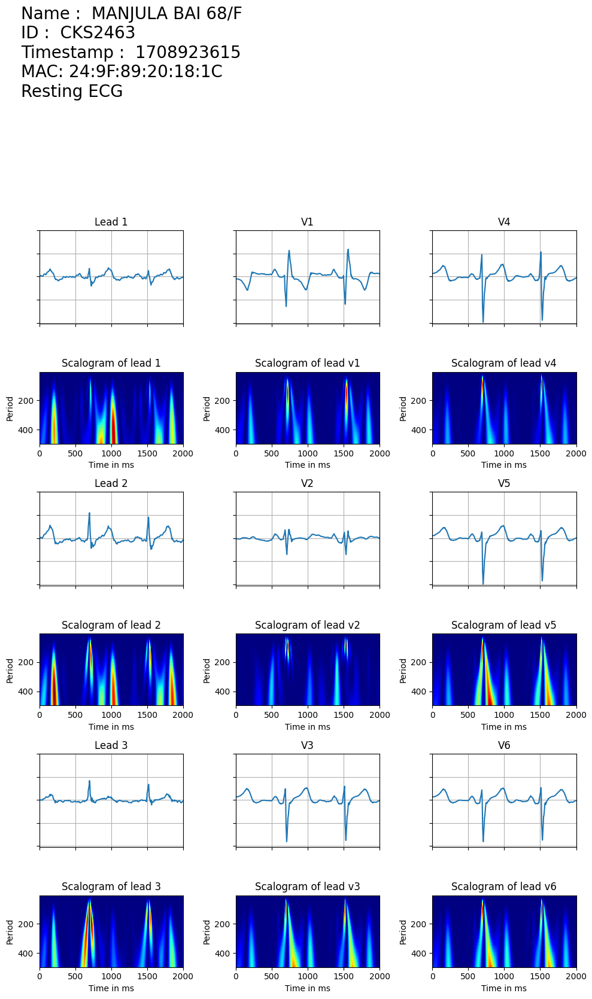

In [ ]:
trialId ="CKS2463"
name = 'Manjula Bai'; name = name.upper()
age_gender ='68/F'
ts= 1708923615 +(15*0)
date,time = get_time_from_timestamp(ts)
# macId ='E4:E1:12:C4:CD:0C'
macId ='24:9F:89:20:18:1C'
His = 'Resting ECG'

Fs=1000

file_name = str(trialId)
###-----------------Starting Point of ECG Segment------------------------##
start = 500

buffer = client.fetch(macId,ts)
frame = buffer.frame;
Lead1 = frame.i; Lead2 = frame.ii; v1 = frame.v1; v2 = frame.v2; v3 = frame.v3; v4 = frame.v4; v5 = frame.v5; v6 = frame.v6 ##############    to add V6 enter V5 Here

##------------------------------Leads value: ADS value multiplied with resolution-------------------------------------##
gain = 1.2;

Lead1 = ((Lead1)*0.000286)*(-(gain)); Lead2 = ((Lead2)*0.000286)*(-(gain));
v1 = ((v1)*0.000286)*(-(gain));v2 = ((v2)*0.000286)*(-(gain));v3 = ((v3)*0.000286)*(-(gain));
v4 = ((v4)*0.000286)*(-(gain));v5 = ((v5)*0.000286)*(-(gain));v6 = ((v6)*0.000286)*(-(gain));

######-------------------------- Leads with Version 5 smoothing Filter-----------------------#####
# Leadv2=filt2(v2,BW=111)
# Lead2=notch_filter(Lead2)
# Lead2=filt2(Lead2,BW=101)
Lead1 = ecg_filters_V5_smooth(Lead1); Lead2 = ecg_filters_V5_smooth(Lead2);
Leadv1 = ecg_filters_V5_smooth(v1); Leadv2 = ecg_filters_V5_smooth(v2); Leadv3 = ecg_filters_V5_smooth(v3);
Leadv4 = ecg_filters_V5_smooth(v4); Leadv5 = ecg_filters_V5_smooth(v5); Leadv6 = ecg_filters_V5_smooth(v6);


fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9), (ax10, ax11, ax12), (ax13, ax14, ax15), (ax16, ax17, ax18)) = \
plt.subplots(6, 3, figsize=(10,15), gridspec_kw={'height_ratios': [1.3, 1, 1.3, 1, 1.3, 1]})
fig.subplots_adjust(hspace=1)
Patient_Details = ("Name :  %s %s \nID :  %s \nTimestamp :  %d  \nMAC: %s\n%s"%(name,age_gender,trialId,ts,macId,His))
fig.suptitle(Patient_Details,fontsize=20,ha = 'left', y=1.11, x=0.04)
#------------- ECG plot -------------#
Lead3=Lead2-Lead1
ecgplot_DD(ax1,Lead1,'Lead 1'); ecgplot_DD(ax7,Lead2,'Lead 2'); ecgplot_DD(ax13,Lead3,'Lead 3')
ecgplot_DD(ax2,Leadv1,'V1'); ecgplot_DD(ax8,Leadv2,'V2'); ecgplot_DD(ax14,Leadv3,'V3')
ecgplot_DD(ax3,Leadv4,'V4'); ecgplot_DD(ax9,Leadv5,'V5'); ecgplot_DD(ax15,Leadv6,'V6')
#------------- Spectrogram Plot -------------#
#scalogram_DD(ax4,Lead1,'Scalogram of lead 1'); scalogram_DD(ax10,Lead2,'Scalogram of lead 2'); scalogram_DD(ax16,Lead3,'Scalogram of lead 3')
# Convert array elements to integers
#integer_array = original_array.astype(int)
np.int = np.int16  # typecasting np.int32

#scalogram_DD(ax4,Lead1,'Scalogram of lead 1');
scalogram_DD(ax4,Lead1,'Scalogram of lead 1');

scalogram_DD(ax10,Lead2,'Scalogram of lead 2'); scalogram_DD(ax16,Lead3,'Scalogram of lead 3')

scalogram_DD(ax5,Leadv1,'Scalogram of lead v1'); scalogram_DD(ax11,Leadv2,'Scalogram of lead v2'); scalogram_DD(ax17,Leadv3,'Scalogram of lead v3')
scalogram_DD(ax6,Leadv4,'Scalogram of lead v4'); scalogram_DD(ax12,Leadv5,'Scalogram of lead v5'); scalogram_DD(ax18,Leadv6,'Scalogram of lead v6')
plt.tight_layout()


# plt.savefig(('/content/drive/MyDrive/Carditek Report for Celara/12-LeadDiastolicDysfunction/DD_testing/Power_int32/'+trialId+'_'+name+'_'+date+'DD.tif'), bbox_inches='tight')
# plt.savefig(('/content/drive/MyDrive/Carditek Report for Celara/12-LeadDiastolicDysfunction/DD_testing/Power_int16/'+trialId+'_'+name+'_'+date+'DD.tif'), bbox_inches='tight')

plt.savefig(('/content/drive/MyDrive/Carditek Report for Celara/12-LeadDiastolicDysfunction/DD_testing/'+trialId+'_'+name+'_'+date+'DD.tif'), bbox_inches='tight')
# plt.savefig(('/content/drive/MyDrive/Carditek_Report_for_Celara/12-LeadDiastolicDysfunction/'+trialId+'_'+name+'_'+date+'DD.tif'), bbox_inches='tight')
# plt.savefig(('/content/drive/MyDrive/King Georges Report/Diastolic Dysfunction/'+trialId+'_'+name+'_'+date+'DD.pdf'), bbox_inches='tight')

# plt.savefig(('/content/drive/MyDrive/Holter Report/Testing/'+tialId+'_'+name+'DD.pdf'), bbox_inches='tight')

In [ ]:
import gspread
from google.auth import default
creds, _ = default()
gc = gspread.authorize(creds)

def getMacId(xrow,xcolumn):
  macId=sbs.cell(xrow,xcolumn).value
  return(macId)

def gettimestamp(xrow,xcolumn):
  #xcolumn=xcolumn+1
  ts=int(sbs.cell(xrow,xcolumn).value)
  return(ts)

<ipython-input-73-c2b2f706e30d>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.subplots(6, 3, figsize=(10,15), gridspec_kw={'height_ratios': [1.3, 1, 1.3, 1, 1.3, 1]})


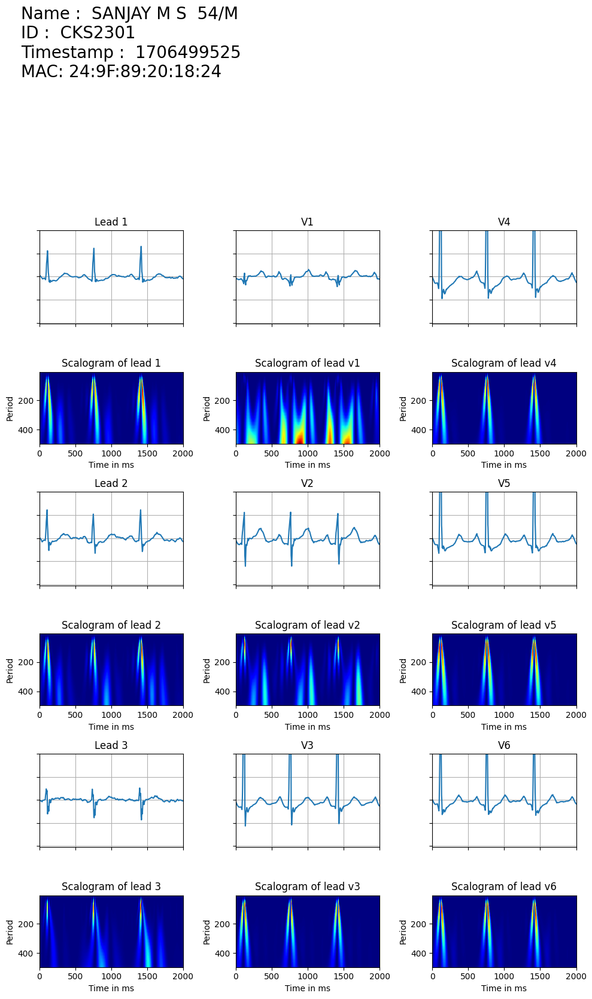

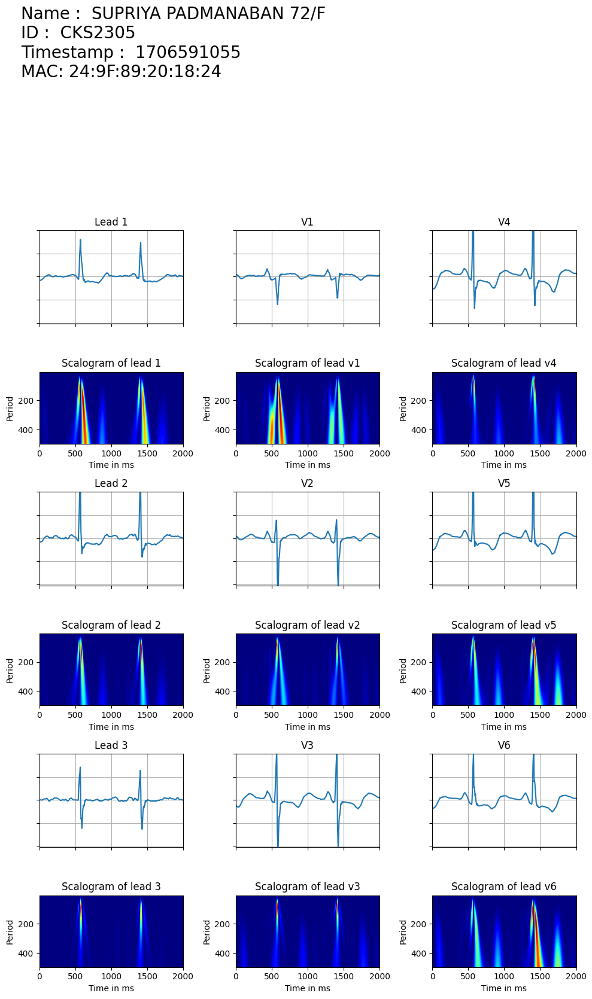

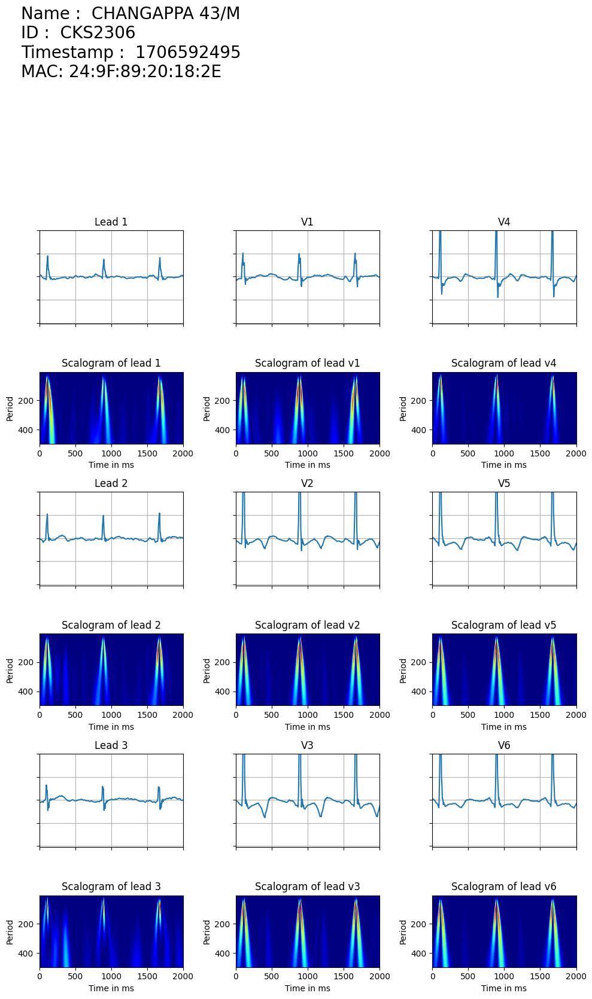

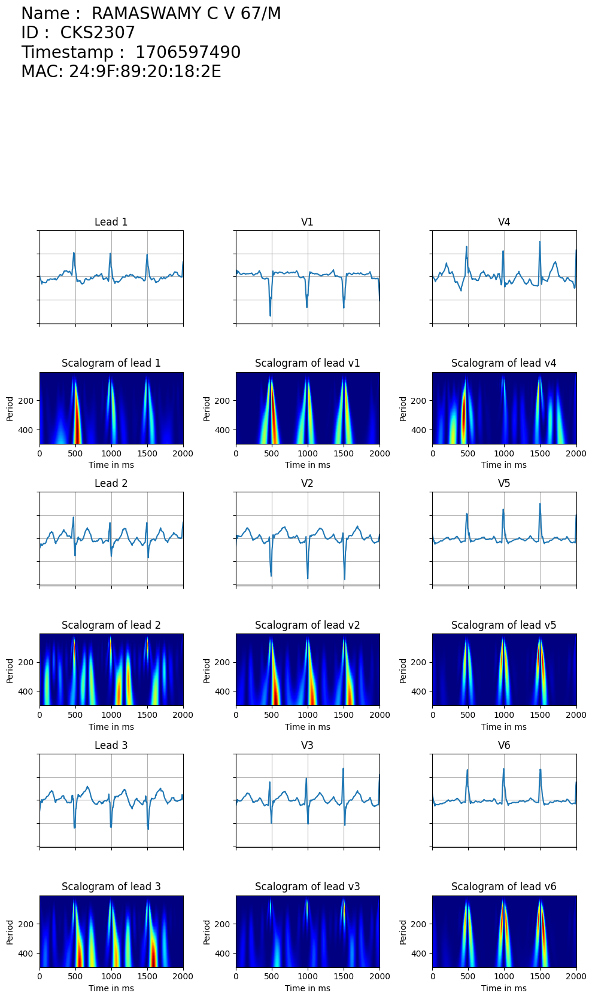

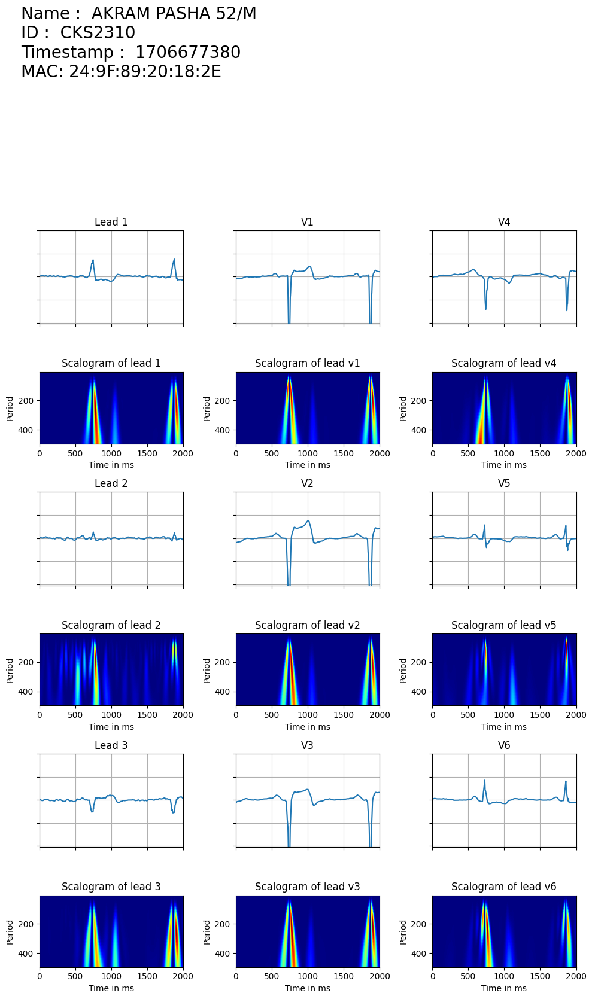

...

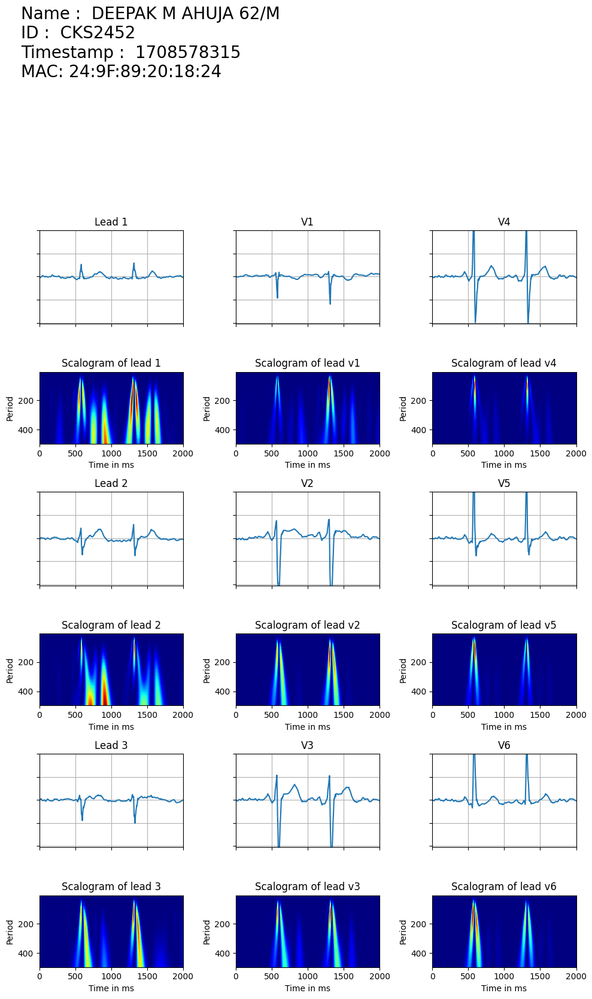

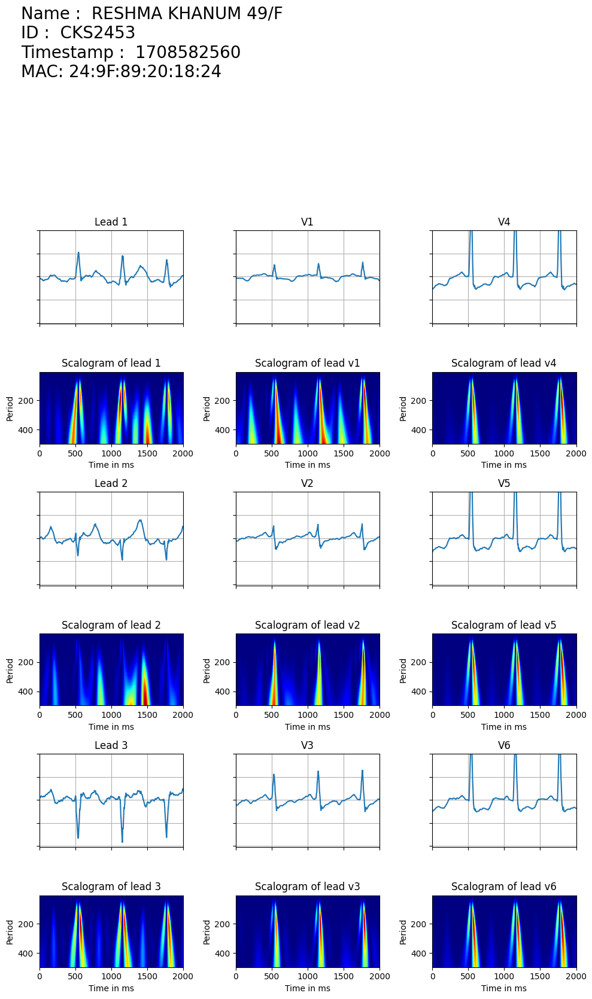

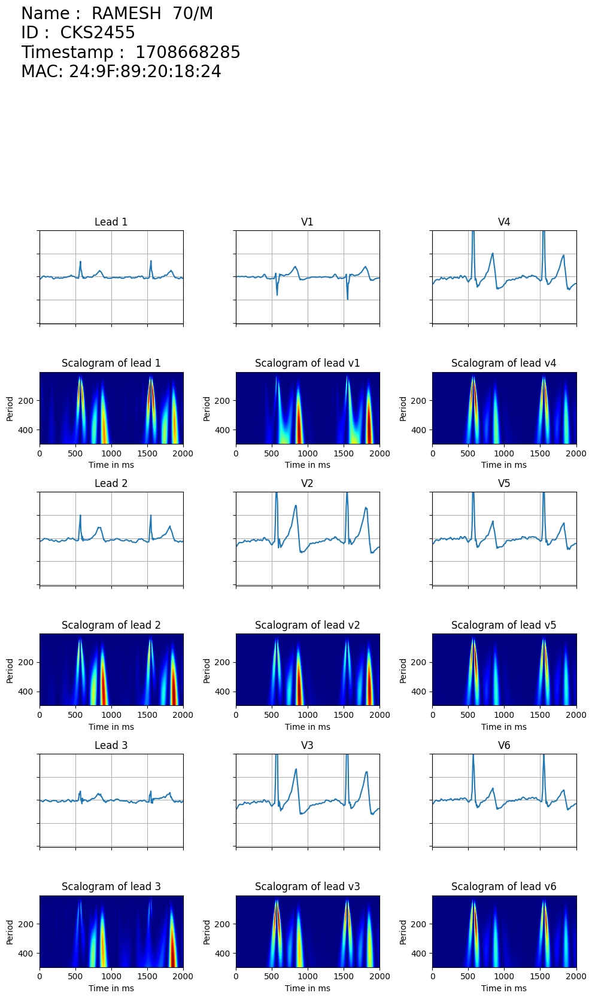

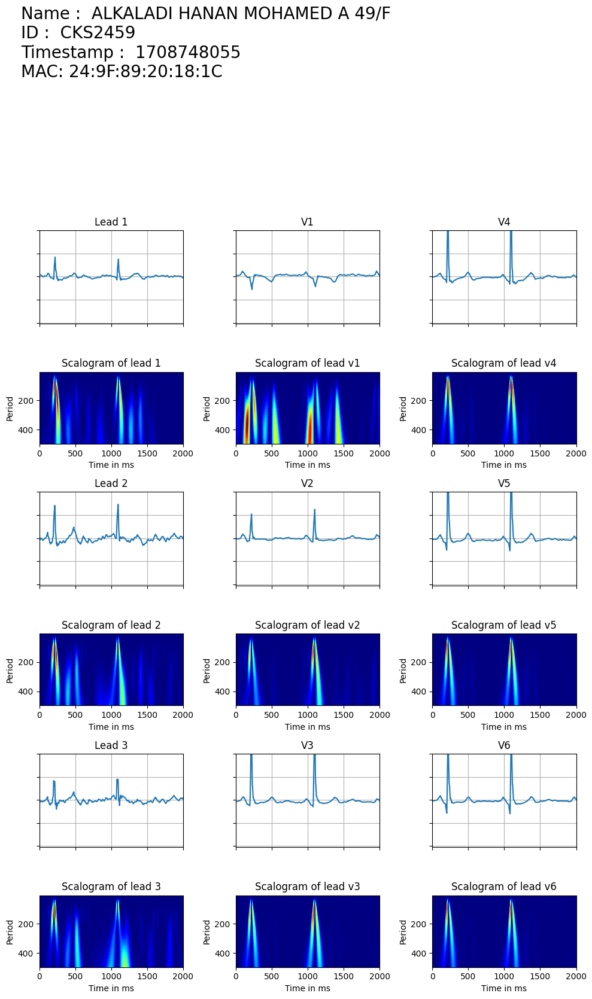

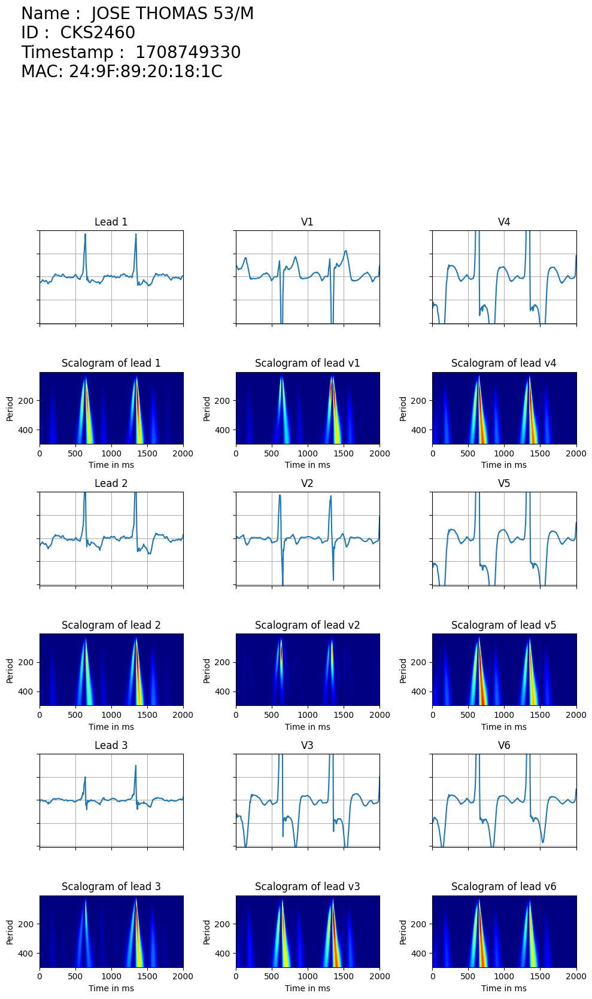

In [ ]:
sh = gc.open_by_url('https://docs.google.com/spreadsheets/d/15oyvGbhoHeiHGkiJQ7ELkpm5ObjrQTQ9Qt9uOt4j3Uk/edit?pli=1#gid=1702893661')
sbs = sh.worksheet('Diastolic_Dysfunction')

Save = True    # keep True to save the image
Save_Path = '/content/drive/MyDrive/Carditek Report for Celara/12-LeadDiastolicDysfunction/DD_testing/Power_int32/'

Start_Row = 50
Stop_Row = 124
fig_index = 0

for m in range(Start_Row, Stop_Row):
  ts = gettimestamp(m,11)
  macId = getMacId(m,10)

  trialId = sbs.cell(m,2).value
  name = sbs.cell(m,3).value; name = name.upper()
  age_gender = sbs.cell(m,4).value;  gender = sbs.cell(m,5).value; age_gender = age_gender+'/'+gender
  date,time = get_time_from_timestamp(ts)
  His = ''
  Fs=1000

  # file_name = trialId+'_DD_power_int32'+'_'+date
  file_name = trialId+'_DD_power_int32'+'_'+date
  ###-----------------Starting Point of ECG Segment------------------------##
  start = 500

  buffer = client.fetch(macId,ts)
  frame = buffer.frame;
  Lead1 = frame.i; Lead2 = frame.ii; v1 = frame.v1; v2 = frame.v2; v3 = frame.v3; v4 = frame.v4; v5 = frame.v5; v6 = frame.v6 ##############    to add V6 enter V5 Here

  ##------------------------------Leads value: ADS value multiplied with resolution-------------------------------------##
  gain = 1.2;

  Lead1 = ((Lead1)*0.000286)*(-(gain)); Lead2 = ((Lead2)*0.000286)*(-(gain));
  v1 = ((v1)*0.000286)*(-(gain));v2 = ((v2)*0.000286)*(-(gain));v3 = ((v3)*0.000286)*(-(gain));
  v4 = ((v4)*0.000286)*(-(gain));v5 = ((v5)*0.000286)*(-(gain));v6 = ((v6)*0.000286)*(-(gain));

  ######-------------------------- Leads with Version 5 smoothing Filter-----------------------#####

  Lead1 = ecg_filters_V5_smooth(Lead1); Lead2 = ecg_filters_V5_smooth(Lead2);
  Leadv1 = ecg_filters_V5_smooth(v1); Leadv2 = ecg_filters_V5_smooth(v2); Leadv3 = ecg_filters_V5_smooth(v3);
  Leadv4 = ecg_filters_V5_smooth(v4); Leadv5 = ecg_filters_V5_smooth(v5); Leadv6 = ecg_filters_V5_smooth(v6);


  fig, ((ax1, ax2, ax3),(ax4, ax5, ax6),(ax7, ax8, ax9), (ax10, ax11, ax12), (ax13, ax14, ax15), (ax16, ax17, ax18)) = \
  plt.subplots(6, 3, figsize=(10,15), gridspec_kw={'height_ratios': [1.3, 1, 1.3, 1, 1.3, 1]})
  fig.subplots_adjust(hspace=1)
  Patient_Details = ("Name :  %s %s \nID :  %s \nTimestamp :  %d  \nMAC: %s\n%s"%(name,age_gender,trialId,ts,macId,His))
  fig.suptitle(Patient_Details,fontsize=20,ha = 'left', y=1.11, x=0.04)
  #------------- ECG plot -------------#
  Lead3=Lead2-Lead1
  ecgplot_DD(ax1,Lead1,'Lead 1'); ecgplot_DD(ax7,Lead2,'Lead 2'); ecgplot_DD(ax13,Lead3,'Lead 3')
  ecgplot_DD(ax2,Leadv1,'V1'); ecgplot_DD(ax8,Leadv2,'V2'); ecgplot_DD(ax14,Leadv3,'V3')
  ecgplot_DD(ax3,Leadv4,'V4'); ecgplot_DD(ax9,Leadv5,'V5'); ecgplot_DD(ax15,Leadv6,'V6')
  #------------- Spectrogram Plot -------------#
  #scalogram_DD(ax4,Lead1,'Scalogram of lead 1'); scalogram_DD(ax10,Lead2,'Scalogram of lead 2'); scalogram_DD(ax16,Lead3,'Scalogram of lead 3')
  # Convert array elements to integers
  #integer_array = original_array.astype(int)
  np.int = np.int32  # typecasting np.int32

  #scalogram_DD(ax4,Lead1,'Scalogram of lead 1');
  scalogram_DD(ax4,Lead1,'Scalogram of lead 1');

  scalogram_DD(ax10,Lead2,'Scalogram of lead 2'); scalogram_DD(ax16,Lead3,'Scalogram of lead 3')

  scalogram_DD(ax5,Leadv1,'Scalogram of lead v1'); scalogram_DD(ax11,Leadv2,'Scalogram of lead v2'); scalogram_DD(ax17,Leadv3,'Scalogram of lead v3')
  scalogram_DD(ax6,Leadv4,'Scalogram of lead v4'); scalogram_DD(ax12,Leadv5,'Scalogram of lead v5'); scalogram_DD(ax18,Leadv6,'Scalogram of lead v6')
  plt.tight_layout()
  if Save==True: plt.savefig((Save_Path+file_name+'_DD_testing.png'), bbox_inches='tight')